In [ ]:
import os
from glob import glob
import numpy as np
import dask
import xarray as xr
import cartopy.crs as ccrs
from cmocean import cm
import xgcm

from matplotlib import pyplot as plt
%matplotlib inline

from mitequinox.utils import *

In [2]:
from dask_jobqueue import PBSCluster
local_dir = os.getenv('TMPDIR')
cluster = PBSCluster(local_directory=local_dir)
#print(cluster.job_script())
w = cluster.start_workers(30)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/site-packages/distributed/utils.py:128: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [Errno 101] Network is unreachable
  % (host, default, e), RuntimeWarning)


In [3]:
# get dask handles and check dask server status
from dask.distributed import Client
client = Client(cluster)

In [24]:
client

Client Scheduler: tcp://10.148.0.38:32836 Dashboard: http://10.148.0.38:8787/status,Cluster Workers: 34 Cores: 136 Memory: 1700.00 GB


_________
# 1. Read dataset


### NetCDF

In [4]:
Nf = 1
data_dir = '/home1/scratch/xyu/mit_nc_t/'

filenames_SSU = sorted(glob(data_dir+'SSU_*.nc'))
filenames_SSU = filenames_SSU[:Nf]
ds_SSU = xr.open_mfdataset(filenames_SSU, concat_dim='time', compat='equals')

filenames_SSV = sorted(glob(data_dir+'SSV_*.nc'))
filenames_SSV = filenames_SSV[:Nf]
ds_SSV = xr.open_mfdataset(filenames_SSV, concat_dim='time', compat='equals')

grid = xr.open_dataset('/home1/scratch/xyu/mit_grid.nc', decode_coords=True)

In [6]:
ds = xr.merge([ds_SSU, ds_SSV, grid])
print(ds)

<xarray.Dataset>
Dimensions:  (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, time: 1)
Coordinates:
    dtime    (time) datetime64[ns] dask.array<shape=(1,), chunksize=(1,)>
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * time     (time) float64 5.702e+06
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
    XC       (face, j, i) float32 ...
    YC       (face, j, i) float32 ...
    XG       (face, j_g, i_g) float32 ...
    YG       (face, j_g, i_g) float32 ...
    CS       (face, j, i) float32 ...
    SN       (face, j, i) float32 ...
    rA       (face, j, i) float32 ...
    dxG      (face, j_g, i) float32 ...
    dyG      (face, j, i_g) float32 ...
    Depth    (face, j, i) float32 ...
    rAz      (face, 

In [8]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

In [7]:
#import xgcm
grid = xgcm.Grid(ds, periodic=['X', 'Y'])
grid

<xgcm.Grid>
Y Axis (periodic):
  * center   j (4320) --> left
  * left     j_g (4320) --> center
X Axis (periodic):
  * center   i (4320) --> left
  * left     i_g (4320) --> center

distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.2:44397 remote=tcp://10.148.1.2:57575>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.2:44398 remote=tcp://10.148.1.2:57575>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.2:44399 remote=tcp://10.148.1.2:57575>


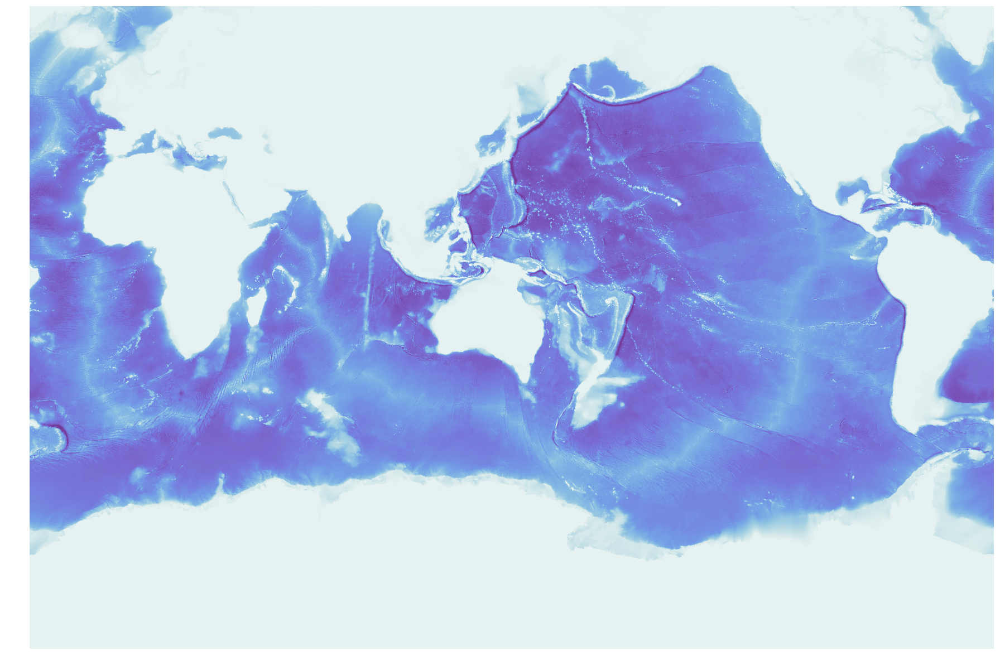

In [8]:
quick_llc_plot(ds.Depth, vmin=0, vmax=10000, add_colorbar=False, axis_off=True, cmap = cm.dense)

# 2. Horizontal divergence

In [9]:
SSV_dxG = ds.dxG * ds['SSV']
SSU_dyG = ds.dyG * ds['SSU']

In [10]:
vel_div_components = grid.diff_2d_vector({'X': SSU_dyG, 'Y': SSV_dxG}, boundary='extend')
print(vel_div_components)

{'X': <xarray.DataArray 'sub-430ac11a23285b96021cd167727681fa' (face: 13, j: 4320, i: 4320, time: 1)>
dask.array<shape=(13, 4320, 4320, 1), dtype=float32, chunksize=(13, 4320, 4319, 1)>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * time     (time) float64 5.702e+06, 'Y': <xarray.DataArray 'sub-0bbfac3d593d20dfd0445a9168faf632' (face: 13, j: 4320, i: 4320, time: 1)>
dask.array<shape=(13, 4320, 4320, 1), dtype=float32, chunksize=(13, 4319, 4320, 1)>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * time     (time) float64 5.702e+06}


In [11]:
vel_div = ((vel_div_components['X'] + vel_div_components['Y'])/ds.rA).load()

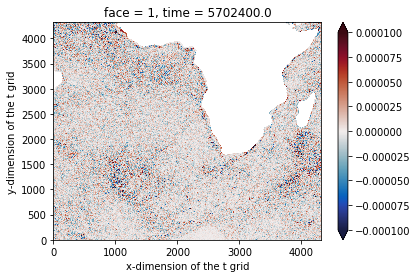

In [16]:
fig = plt.figure(figsize=(16,10))
vel_div_t = vel_div.isel(face=10).transpose()
vel_div_t.plot(vmin=-0.0001, vmax=0.0001, yincrease=False, cmap = cm.balance)

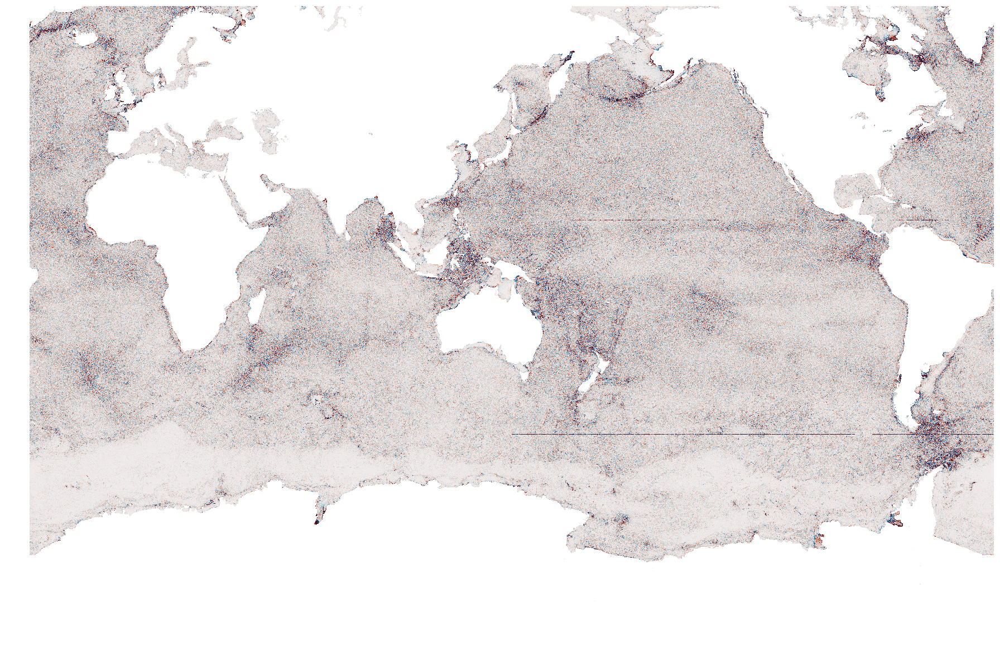

In [12]:
quick_llc_plot(vel_div, vmin = -0.0001, vmax = 0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

# 3. Relative vorticity

In [22]:
zeta = ((-grid.diff(ds.dxC * ds['SSU'], 'Y') + grid.diff(ds.dyC * ds['SSV'], 'X'))/ds.rAz).load()

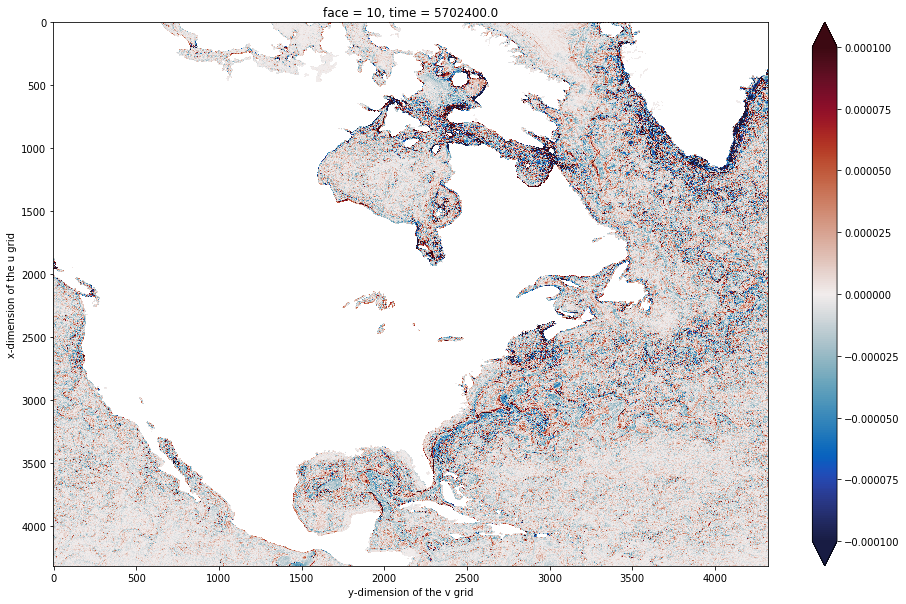

In [23]:
fig = plt.figure(figsize=(16,10))
zeta_time0_t = zeta.isel(face=10).transpose()
zeta_time0_t.plot(vmin=-0.0001, vmax=0.0001, yincrease=False, cmap = cm.balance)

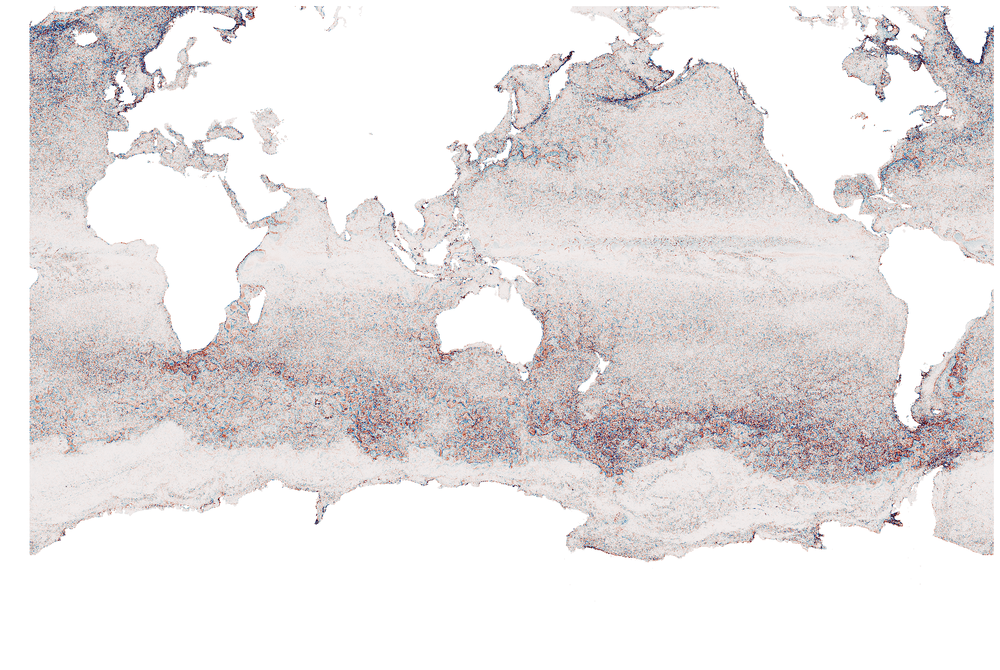

In [24]:
quick_llc_plot(zeta.isel(time=0), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

# 4. Strain rate

In [25]:
strain = ((grid.diff(ds['SSU'] * ds.dyG, 'X') - grid.diff(ds['SSV'] * ds.dxG, 'Y'))/ds.rA).load()

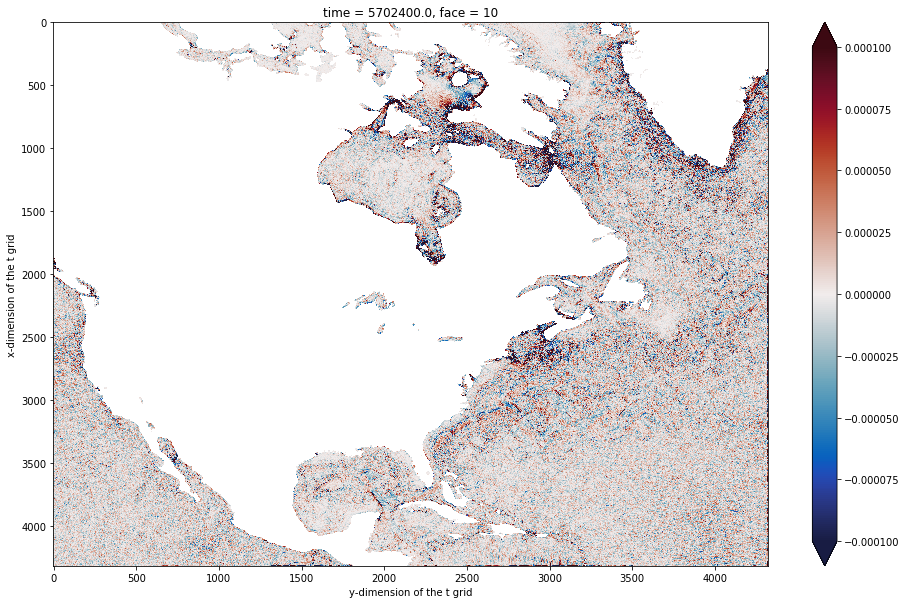

In [26]:
fig = plt.figure(figsize=(16,10))
strain_t = strain.isel(face=10).transpose()
strain_t.plot(vmin=-0.0001, vmax=0.0001, yincrease=False, cmap = cm.balance)

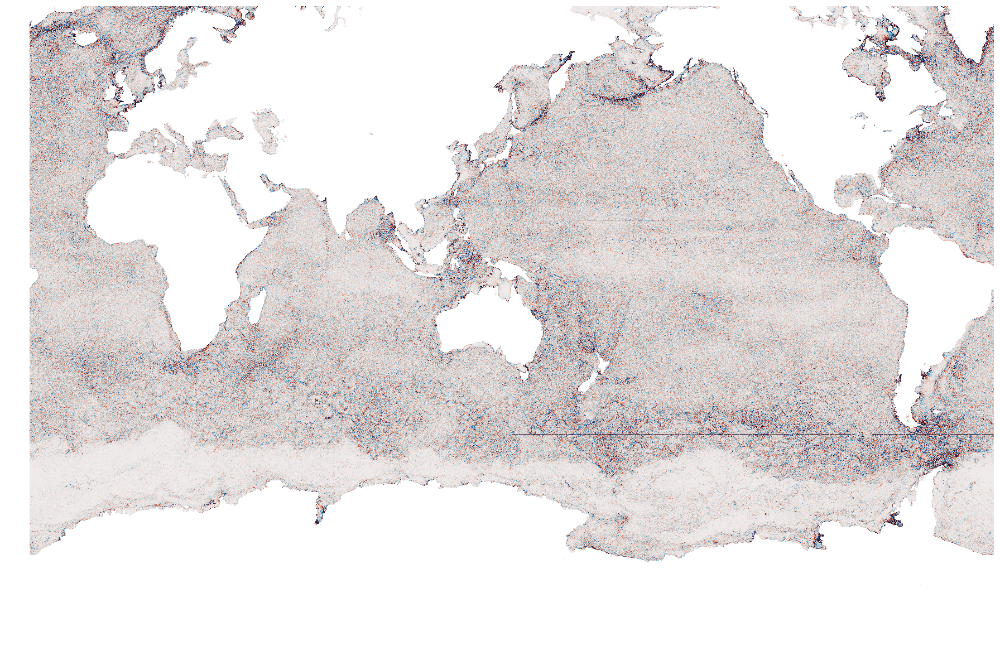

In [27]:
quick_llc_plot(strain.isel(time=0), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

# 5. KE

In [8]:
KE = ((grid.interp(ds['SSU'] * ds['SSU'],'X') + grid.interp(ds['SSV'] * ds['SSV'],'Y'))/2).load()
print(KE)

<xarray.DataArray (time: 1, face: 13, j: 4320, i: 4320)>
array([[[[     nan, ...,      nan],
         ...,
         [     nan, ...,      nan]],

        ...,

        [[0.101395, ...,      nan],
         ...,
         [0.052994, ...,      nan]]]], dtype=float32)
Coordinates:
  * time     (time) float64 5.702e+06
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...


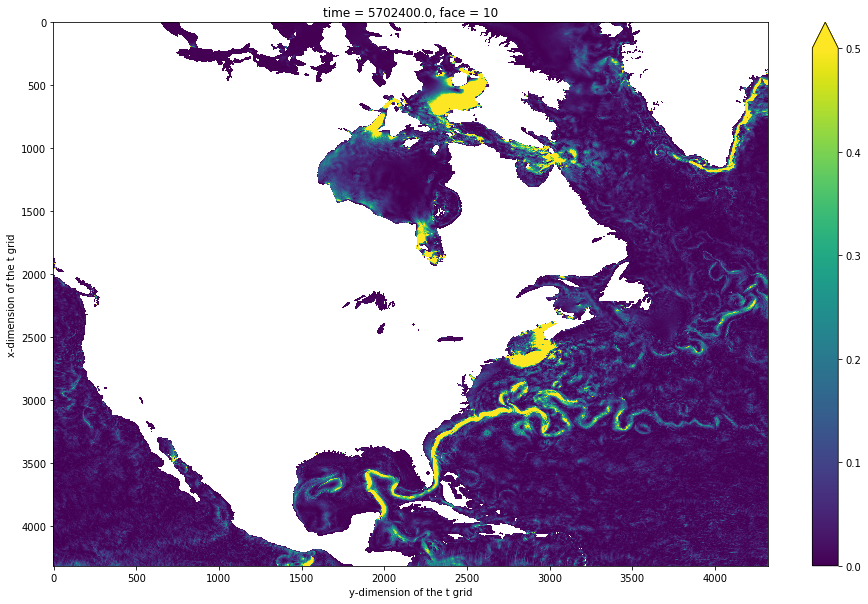

In [11]:
fig = plt.figure(figsize=(16,10))
KE_t = KE.isel(face=10).transpose()
KE_t.plot(vmin=0., vmax=0.5, yincrease=False)

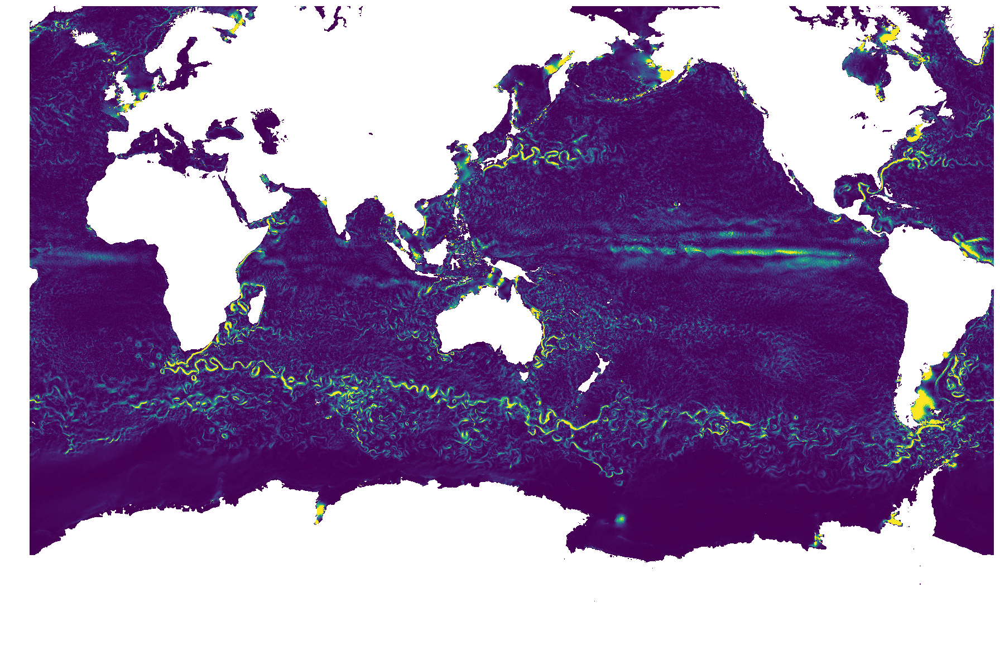

In [47]:
quick_llc_plot(KE, vmin=0, vmax=0.5, add_colorbar=False, axis_off=True)

In [19]:
cluster.scheduler.close()

<Future finished result=None>